In [10]:
from __future__ import division

import json
from glob import glob
from tqdm import tqdm
import sys, os
import pandas as pd
import scanpy as sc
import scvelo as scv
import hotspot
import numpy as np
import scipy
from scipy import stats
import itertools
import warnings
from collections import OrderedDict 
from scipy.stats import zscore
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics.pairwise import cosine_similarity as cosine_similarity_sklearn
import anndata
#plotting
import matplotlib
from matplotlib import pyplot as plt
import matplotlib.patches as patches
import matplotlib.ticker as ticker
import seaborn as sns
warnings.simplefilter(action='ignore', category=FutureWarning)

In [11]:
sys.path.append("utils/")
import utils as utils

In [12]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [13]:
# Plotting style
sc.settings.set_figure_params(dpi=120, fontsize=10, dpi_save=300, frameon=False, format='pdf')
sc.settings.verbosity = 0
sns.set_style(style="white")
sns.set_style("ticks")

# Load modules

In [14]:
import json

clean_modules = "data/clean_modules_IP_IT.json"

with open(clean_modules) as json_file:
    genes = json.load(json_file)

In [15]:
baseline_studies = ['Chakarov', 'Schyns', 'Travaglini_mouse', 'Dicks', 'ural']

injury_studies  = ['LAM', 'osteopontin', 'cardiac', 'IL17', 'asbestos', 'peyser', '2019_Strunz']

cruz_studies = ['IP', 'IT']

baseline_studies_labels = ['Chakarov et al.', 'Schyns el al.', 'Travaglini et al.', 'Dicks et al.', 'Ural et al.']

In [16]:
clusters = {
    'M':['M1', 'M2', 'M3', 'M4'],
    'I':['I1', 'I2', 'I3', 'I4'],
    'A':['A1', 'A2', 'A3']
}

colors = {
    'M': np.array(['tab:purple', '#949494', '#ece133', '#cc78bc'], dtype=object),
    'I': np.array(['#029e73', '#d55e00', '#0173b2', '#de8f05'], dtype=object),
    'A': np.array(['#56b4e9', '#fbafe4', '#ca9161'], dtype=object)}

order_clusters = ["I4", "I3", "I2", "I1", "M4", "M3", "M2", "M1", "A2", "A1", "A3"]

# Load metadata

In [17]:
datasets_df = pd.read_csv("data/external_datasets_metadata.csv").set_index("index")
datasets_df.index.name = None
datasets_df

,study_annotation,practical_annotation,state,organism,author,tissue
Chakarov,cell.type,cell.type,baseline,mouse,Chakarov,Lung
Schyns,meta_cellType,meta_cellType,baseline,mouse,Schyns,Lung
Travaglini_mouse,free_annotation,tissue,baseline,mouse,Travaglini_mouse,Lung
Dicks,meta_sourceName,meta_sourceName,baseline,mouse,Dicks,Lung
ural,meta_sourceName,meta_sourceName,baseline,mouse,Ural,Lung
LAM,clusterID,"meta_timePoint,meta_treatmentDiet",Diet,mouse,Jaitin,Adipose
osteopontin,clusterName,meta_diet,Diet,mouse,Remmerie,Liver
cardiac,clusterID,meta_sourceName,disease,mouse,Farbehi,Heart
IL17,clusterID,meta_treatment,Injury,mouse,Sommerfeld,Skeletal muscle
asbestos,batch,batch,Injury,mouse,Joshi,Lung


In [18]:
metadata_datasets = pd.read_csv("data/external_datasets_metadata_expanded.csv").set_index("Unnamed: 0")
metadata_datasets.index.name = None

In [19]:
metadata_datasets.head()

,study,state,practical_annotation,concise_annotation,study_concise_annotation,tissue,author
0,Schyns,baseline,Tissue CD64+ mononuclear phagocyte,control,Schyns_control,Lung,Schyns
1,Schyns,baseline,CD64+ mononuclear phagocyte,control,Schyns_control,Lung,Schyns
2,Schyns,baseline,Ly-6Chi lung monocyte,control,Schyns_control,Lung,Schyns
3,Schyns,baseline,Ly-6Clo lung monocyte,control,Schyns_control,Lung,Schyns
4,Dicks,baseline,Lung macrophages,control,Dicks_control,Lung,Dicks


In [20]:
# Create dictionary for easy access
datasets = {}
for el in datasets_df.index:
    datasets[el] = {}
    for c in ['study_annotation', 'practical_annotation', 'state', 'organism', 'author', 'tissue']:
        datasets[el][c] = datasets_df.loc[el][c]

In [21]:
# Separate datasets according to tissue

tissue_datasets = {}
for el in datasets_df['tissue'].unique():
    tissue_datasets[el] = datasets_df[datasets_df['tissue']==el].index.tolist()
    print(el, len(tissue_datasets[el]))

Lung 10
Adipose 1
Liver 1
Heart 1
Skeletal muscle 1


# Load data

In [22]:
agg = {}

for t in tqdm(tissue_datasets):
    agg[t] = {}
    for el in tissue_datasets[t]:
        if el == 'IP' or el == 'IT':
            f = f"data/{el}.proc.myeloid.h5ad"
        else:
            f = f"data/external/{el}.proc.myeloid.h5ad"
        agg[t][el] = sc.read_h5ad(f)

100%|██████████| 5/5 [00:31<00:00,  6.27s/it]


# Score gene modules

In [23]:
for t in tqdm(tissue_datasets):
    for el in tissue_datasets[t]:
        for g in genes:
            try:
                sc.tl.score_genes(agg[t][el], gene_list=genes[g], score_name=g)
                # zscore
                agg[t][el].obs[f'zscore_{g}'] = zscore(agg[t][el].obs[g])
            except:
                print(t, el, g)

100%|██████████| 5/5 [00:25<00:00,  5.10s/it]


# Concatenate obs from all datasets to facilitate some visualizations

In [24]:
obs_df = pd.DataFrame()

for t in agg:
    for el in agg[t]:
        tmp = agg[t][el].obs
        obs_df = pd.concat([obs_df, tmp])

# clean and order datasets
obs_df = obs_df[obs_df['combined_clusters'].isin(order_clusters)]
obs_df.loc[(obs_df['study']=='2019_Strunz')&(obs_df['practical_annotation']=='PBS'), 'state'] = 'baseline'
obs_df.loc[(obs_df['study']=='LAM')&(obs_df['practical_annotation']=='18.0,Normal chow'), 'state'] = 'baseline'
obs_df.loc[(obs_df['study']=='osteopontin')&(obs_df['practical_annotation']=='standard diet'), 'state'] = 'baseline'
obs_df['state'] = obs_df['practical_annotation'].map({k:v for k, v in zip(metadata_datasets['practical_annotation'], metadata_datasets['state'])})
order_state = utils.summarize(obs_df[obs_df['combined_clusters'].isin(clusters['I'])], 'state', 'combined_clusters', 'pct', None).T.sort_values(by='I4').index.tolist()[::-1]
obs_df['state'] = obs_df['state'].astype("category").cat.reorder_categories(order_state)
obs_df['combined_clusters'] = obs_df['combined_clusters'].astype("category").cat.reorder_categories(order_clusters)
obs_df.loc[(obs_df['study']=='2019_Strunz')&(obs_df['practical_annotation']=='PBS'), 'state'] = 'baseline'
obs_df.loc[(obs_df['study']=='LAM')&(obs_df['practical_annotation']=='18.0,Normal chow'), 'state'] = 'baseline'
obs_df.loc[(obs_df['study']=='osteopontin')&(obs_df['practical_annotation']=='standard diet'), 'state'] = 'baseline'

# Figure 6a

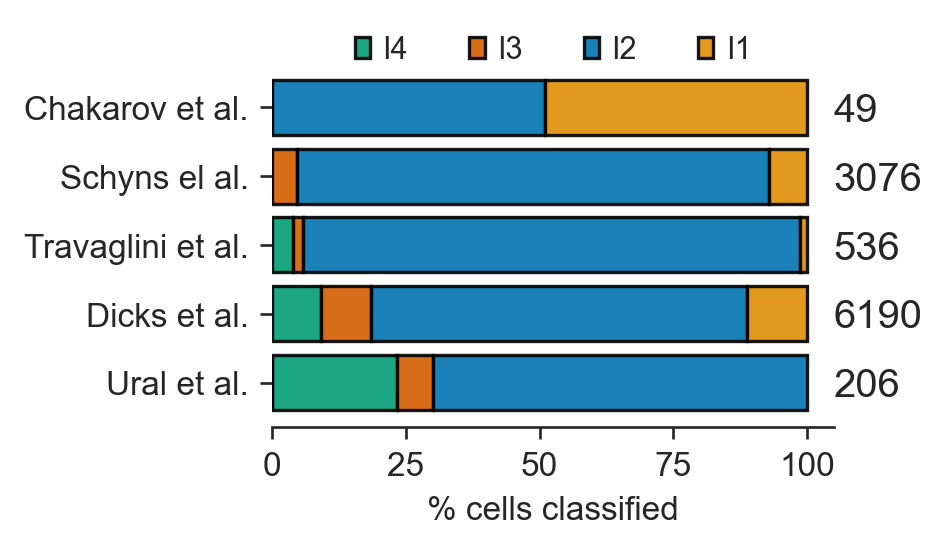

In [25]:
with plt.rc_context({"font.size" : 12}):
    f, ax = plt.subplots(figsize=(3, 2))

    utils.plotbarcomplete(obs_df[
        (obs_df['study'].isin(baseline_studies))& (obs_df['state']=='baseline') &
        (obs_df['combined_clusters'].isin(clusters['I']))], 'study', 'combined_clusters', #order_studies_simple,
                    colors['I'].tolist(), ax,  order=baseline_studies[::-1])
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=11, frameon=False)
    ax.set_yticklabels(baseline_studies_labels[::-1])
    ax.set_xlabel('% cells classified')
    ax.set_ylabel('')
    sns.despine(left=True)

# Figure 6b

In [26]:
def plot_bar_studies(df, group, order, xlabel, y, ax, labels=None):
    x = 'combined_clusters'
    tmp = df[df[x].isin(clusters[group])]
    
    utils.plotbarcomplete(tmp, y, x, colors[group].tolist(), ax,  order=order)
    ax.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), ncol=1, frameon=False)
    if labels != None:
        ax.set_yticklabels(labels)
    ax.set_xlabel(xlabel)
    ax.set_ylabel('')
    ax.set_ylabel('') 
    
df = obs_df[obs_df['study'].isin(injury_studies)]
df['ann'] = df['study'].astype(str) + '-' + df['state'].astype(str)

order_studies_pert = ['LAM-Diet', 'osteopontin-Diet', 'cardiac-Injury', 'IL17-Injury', 'asbestos-Injury', 'peyser-Injury', '2019_Strunz-Injury', ]
order_studies_control = ['LAM-baseline', 'osteopontin-baseline', 'cardiac-baseline', 'IL17-baseline', 'asbestos-baseline',  'peyser-baseline', '2019_Strunz-baseline',]

order_studies_pert_label = ['Fat Pad - HFD - Jaitin et al', 'Liver - HFD - Remmerie et al', 'Heart - MI - Farbehi et al', 'Muscle - Injury - Sommerfeld et al',
                            'Lung - Asbestos - Joshi et al', 'Lung - Bleomycin - Peyser et al', 'Lung - Bleomycin - Strunz et al'
                           ]

order_studies_control_label = ['Fat Pad - steady state', 'Liver - steady state', 'Heart - steady state', 'Muscle - steady state',
                            'Lung - steady state', 'Lung - steady state', 'Lung - steady state'
                           ]

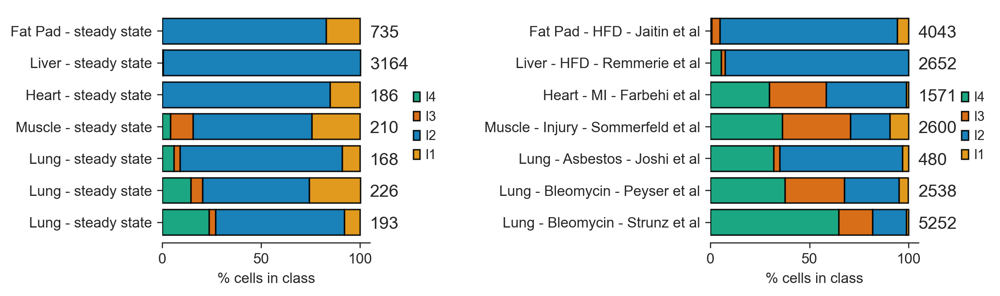

In [27]:
group='I'

with plt.rc_context({"font.size" : 12}):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 3))
    
    plot_bar_studies(
        df[df['state']!='baseline'], 
        group, 
        order=order_studies_pert[::-1], 
        xlabel='% cells in class', 
        y='ann', 
        ax=ax2,
        labels=order_studies_pert_label[::-1])


    plot_bar_studies(
        df[df['state']=='baseline'], 
        group, 
        order=order_studies_control[::-1], 
        xlabel='% cells in class', 
        y='ann', 
        ax=ax1,
        labels=order_studies_control_label[::-1])

    sns.despine(left=True)
    plt.tight_layout()

# Figure 6d

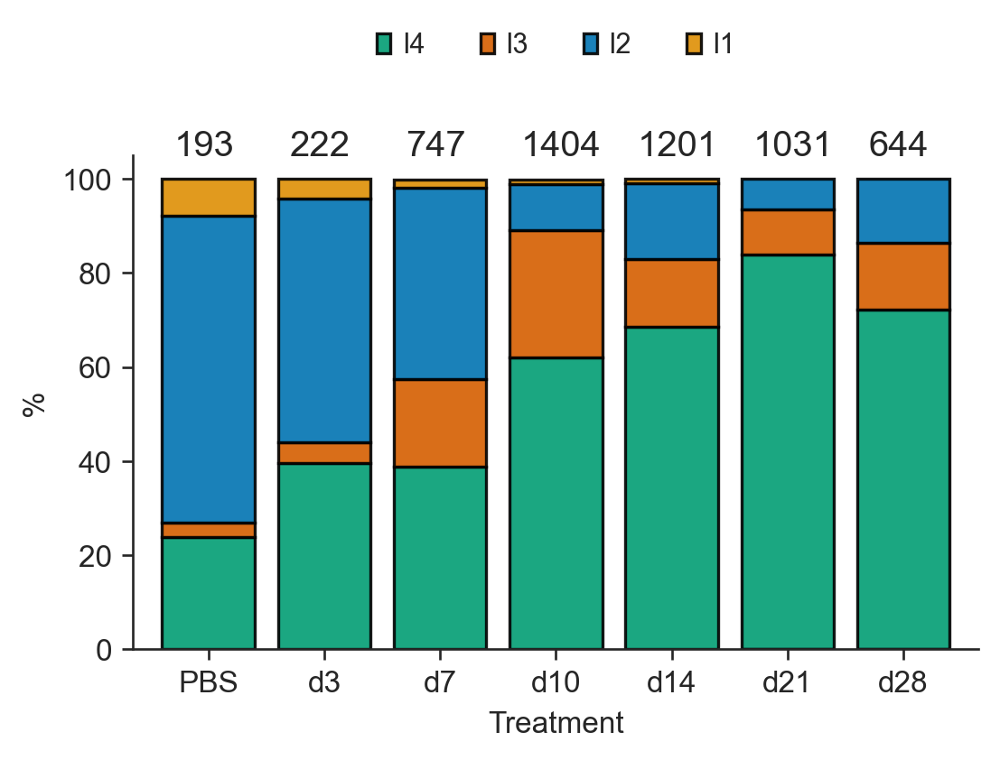

In [28]:
# Strunz
dat = '2019_Strunz'
strunz_samples = ['PBS', 'd3', 'd7', 'd10', 'd14', 'd21', 'd28']

with plt.rc_context({"font.size" : 12}):
    f, ax1 = plt.subplots(1, figsize=(5, 3))

    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters', 
                    colors['I'].tolist(), ax1,  order=None, kind='bar')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax1.set_xticklabels(strunz_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')

# Figure 6e

In [29]:
strunz_tidy = pd.melt(agg['Lung']['2019_Strunz'].obs, id_vars=['concise_annotation'], value_vars=[f'zscore_{g}' for g in genes])
strunz_tidy['time'] = strunz_tidy['concise_annotation'].map({
    'control':0,
    'bleomycin_d3':3,
    'bleomycin_d7':7,
    'bleomycin_d10':10,
    'bleomycin_d14':14,
    'bleomycin_d21':21,
    'bleomycin_d28':28,
})

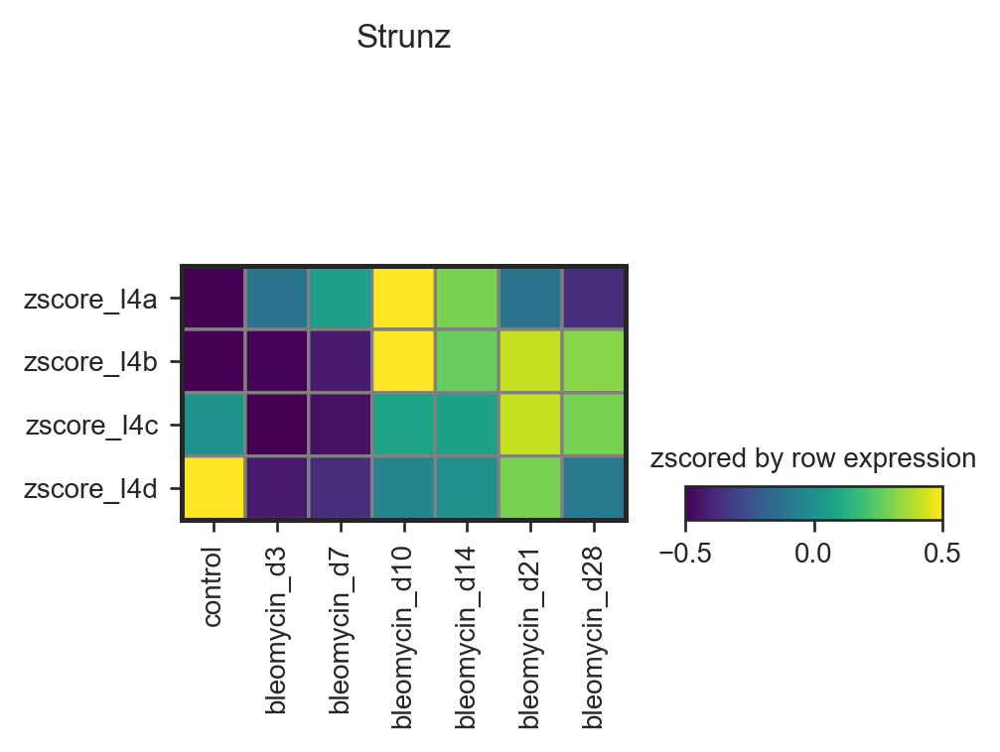

In [30]:
s, el = 'Lung', '2019_Strunz'
author = agg[s][el].obs['author'].unique()[0]
sc.pl.matrixplot(agg[s][el], groupby='concise_annotation', 
                 var_names=['zscore_I4a', 'zscore_I4b', 'zscore_I4c', 'zscore_I4d'], swap_axes=True, 
                 vmin=-0.5, vmax=0.5, 
                 colorbar_title='zscored by row expression', title=f'{author}',
                 cmap='viridis', linewidth=1)

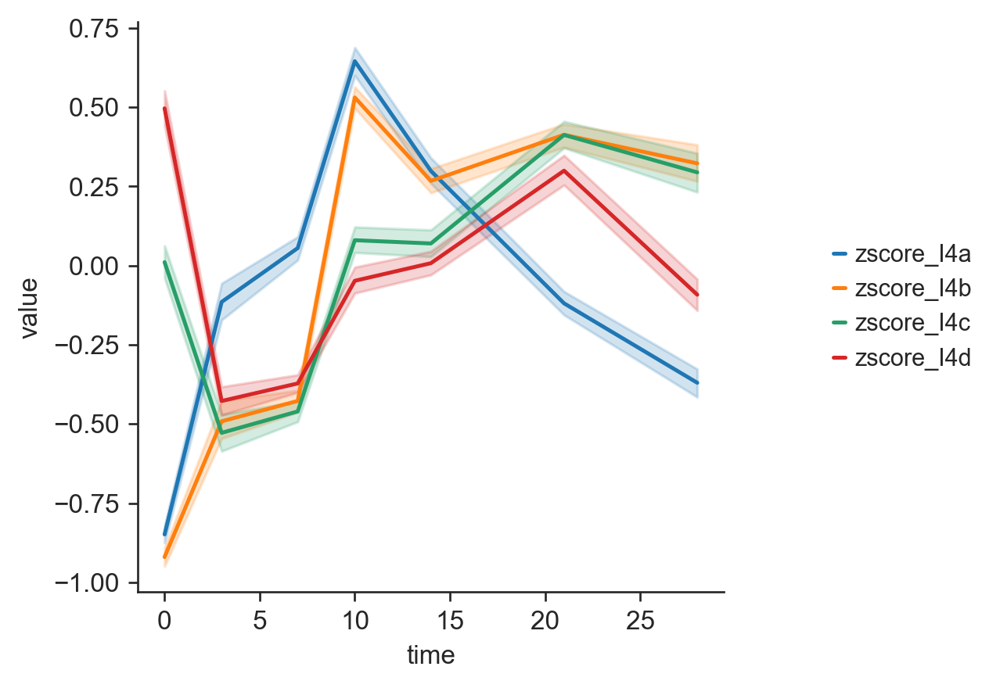

In [31]:
with plt.rc_context({"font.size" : 12}):
    f, ax1 = plt.subplots()

    sns.lineplot(data=strunz_tidy, x='time', y='value', hue='variable', ci=95, ax=ax1)
    ax1.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), ncol=1, frameon=False)
    sns.despine()

# Extended Figure 6d

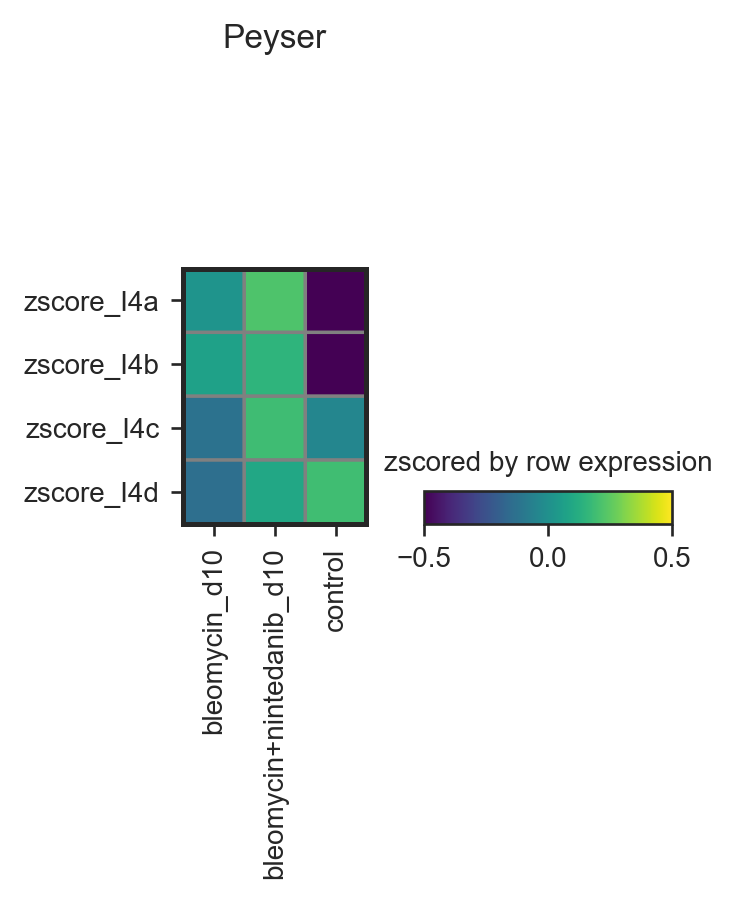

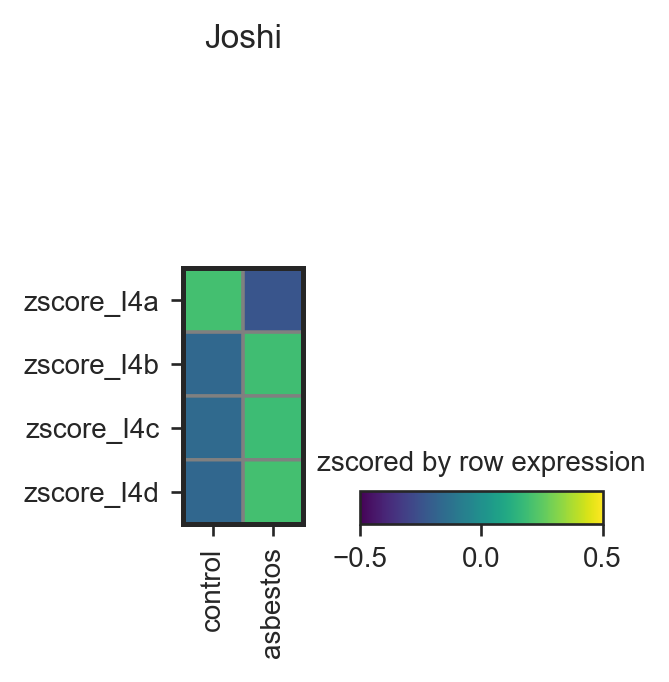

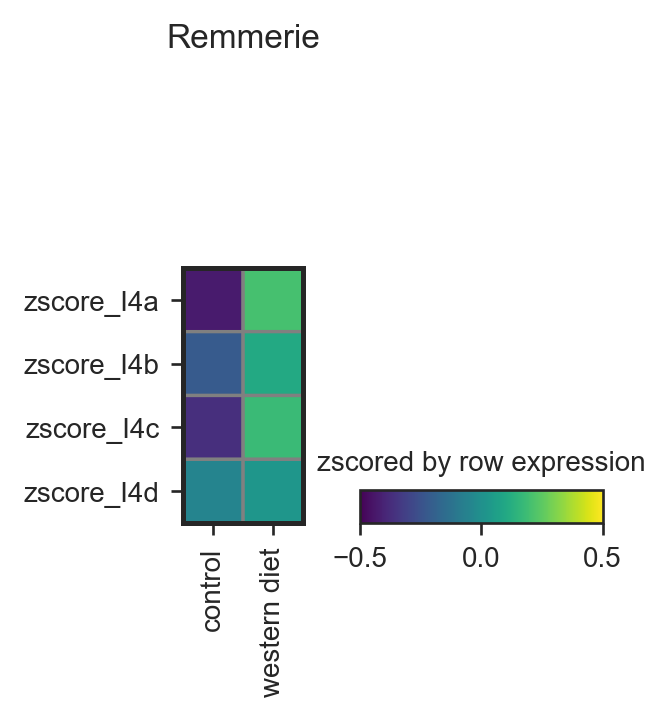

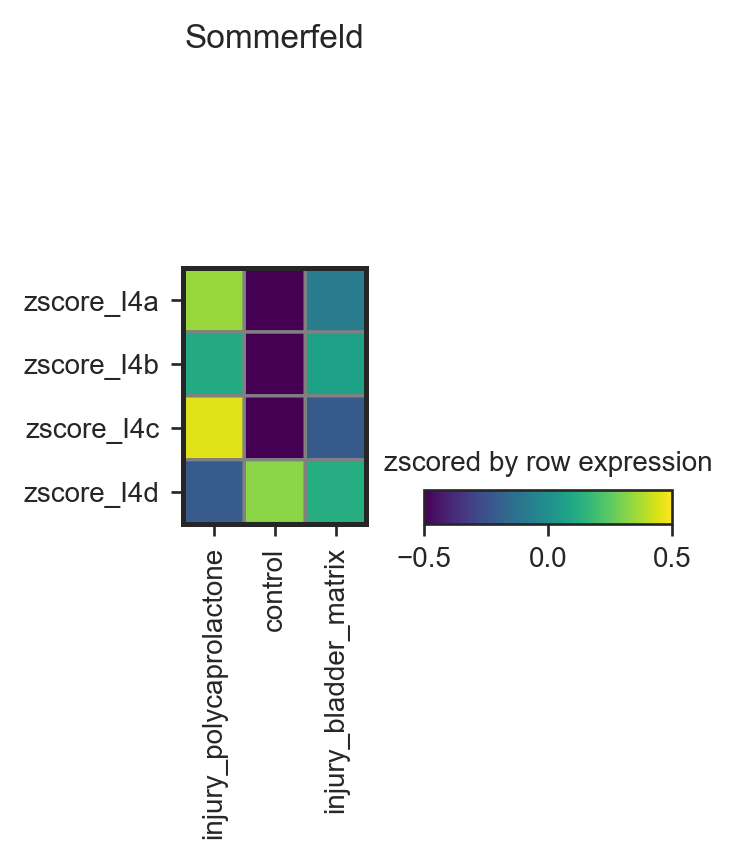

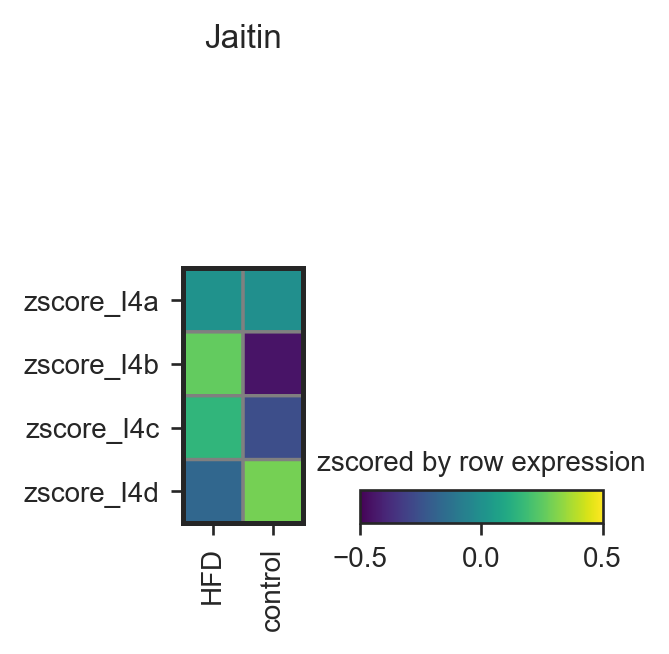

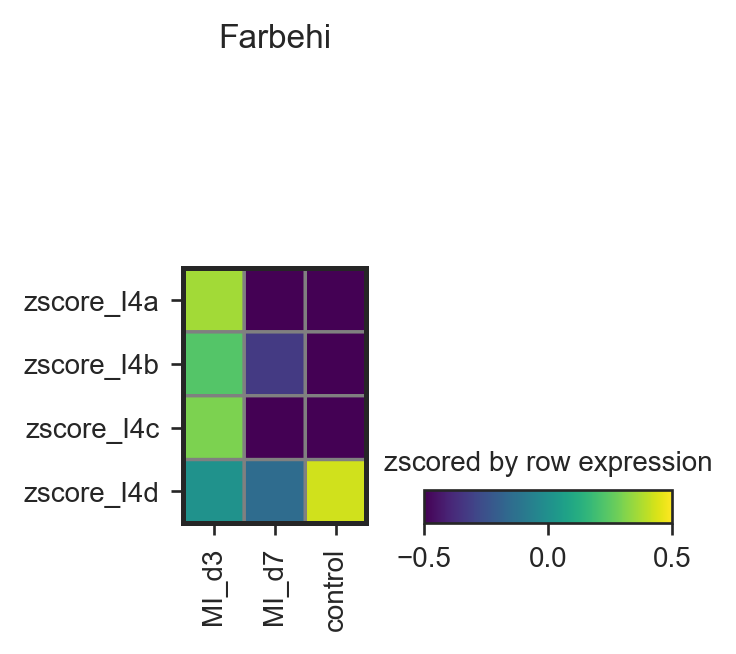

In [32]:
for s, el in zip(['Lung', 'Lung', 'Liver', 'Skeletal muscle', 'Adipose', 'Heart'], ['peyser', 'asbestos', 'osteopontin', 'IL17', 'LAM', 'cardiac']):
    author = agg[s][el].obs['author'].unique()[0]

    sc.pl.matrixplot(agg[s][el], groupby='concise_annotation', 
                 var_names=['zscore_I4a', 'zscore_I4b', 'zscore_I4c', 'zscore_I4d'], swap_axes=True, 
                     vmin=-0.5, vmax=0.5, 
                     colorbar_title='zscored by row expression', title=f'{author}',
                     cmap='viridis', linewidth=1)

# Study annotations in Extended figure 6e

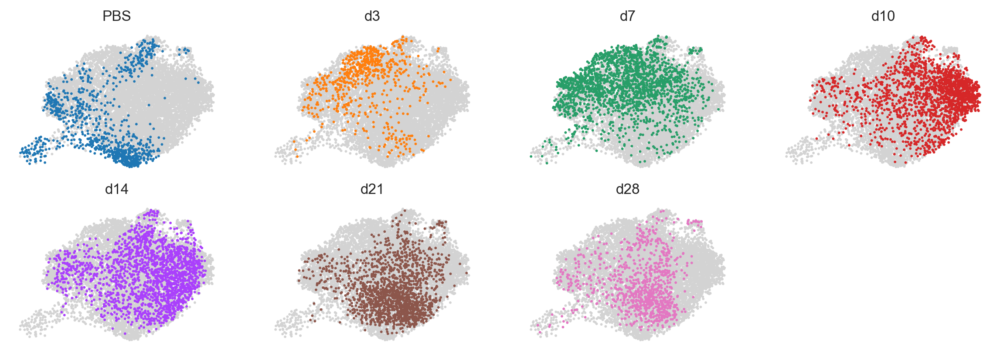

In [33]:
with plt.rc_context({"font.size" : 12}):
    f, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4, figsize=(12, 4))

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['control'], show=False, title='PBS', legend_loc='', ax=ax1)

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['bleomycin_d3'], show=False, title='d3', legend_loc='', ax=ax2)

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['bleomycin_d7'], show=False, title='d7', legend_loc='', ax=ax3)

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['bleomycin_d10'], show=False, title='d10', legend_loc='', ax=ax4)

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['bleomycin_d14'], show=False, title='d14', legend_loc='', ax=ax5)

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['bleomycin_d21'], show=False, title='d21', legend_loc='', ax=ax6)

    sc.pl.umap(agg['Lung']['2019_Strunz'][agg['Lung']['2019_Strunz'].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=['bleomycin_d28'], show=False, title='d28', legend_loc='', ax=ax7)

    f.delaxes(ax8)

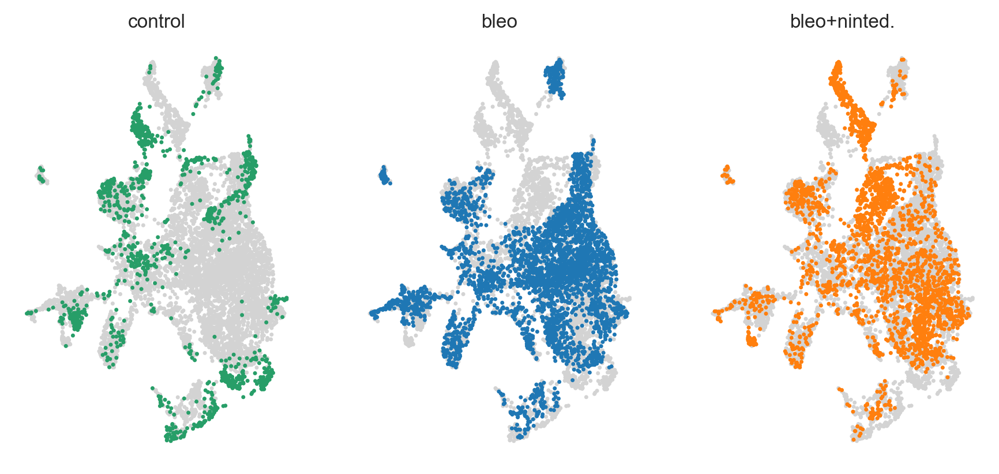

In [34]:
t = 'Lung'
s = 'peyser'
author = agg[t][s].obs['author'].unique()[0]
anns = ['control', 'bleomycin_d10', 'bleomycin+nintedanib_d10'] 
ts = ['control', 'bleo', 'bleo+ninted.'] 

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(9, 4))

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[0], show=False, title=ts[0], legend_loc='', ax=ax1)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[1], show=False, title=ts[1], legend_loc='', ax=ax2)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[2], show=False, title=ts[2], legend_loc='', ax=ax3)

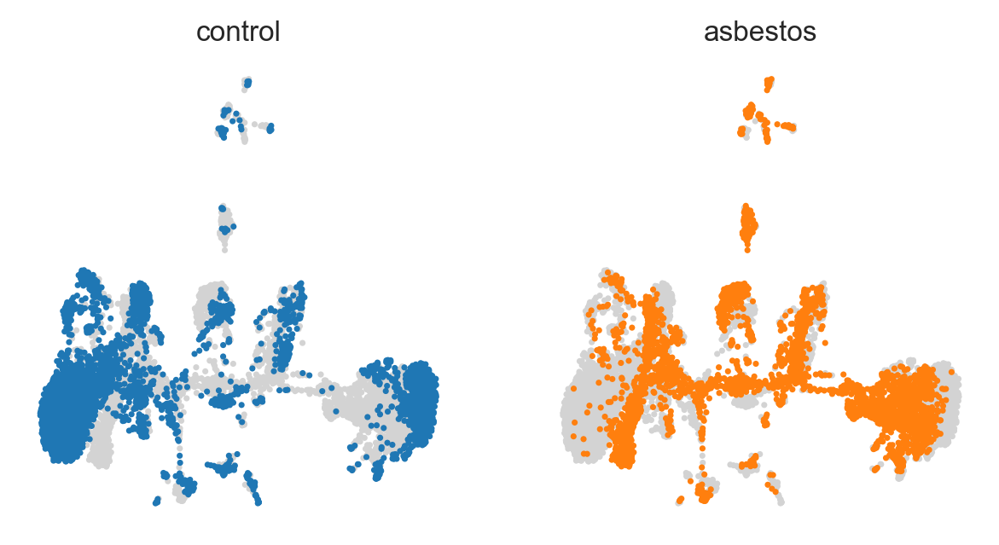

In [35]:
t = 'Lung'
s = 'asbestos'
author = agg[t][s].obs['author'].unique()[0]
anns = ['control', 'asbestos']
ts = ['control', 'asbestos']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 3))

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[0], show=False, title=ts[0], legend_loc='', ax=ax1)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[1], show=False, title=ts[1], legend_loc='', ax=ax2)

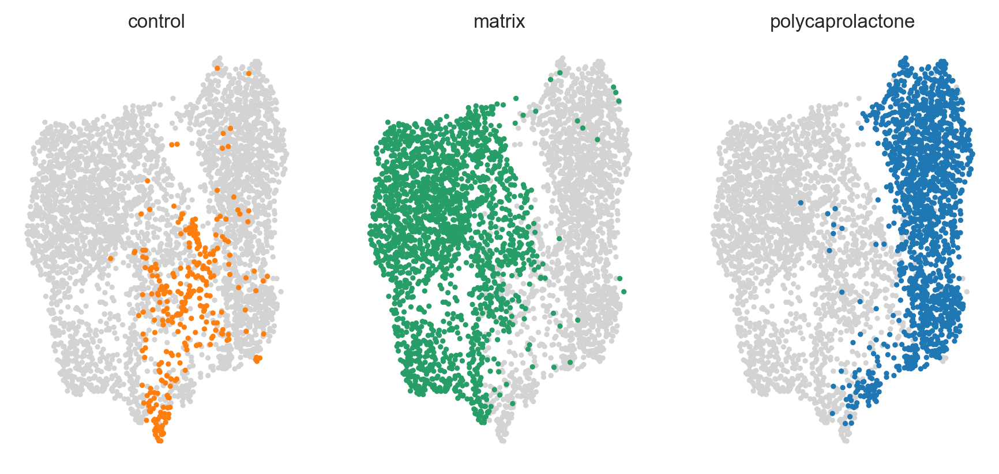

In [36]:
t = 'Skeletal muscle'
s = 'IL17'
author = agg[t][s].obs['author'].unique()[0]
anns = ['control', 'injury_bladder_matrix', 'injury_polycaprolactone']
ts = ['control', 'matrix', 'polycaprolactone'] 

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(9, 4))

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[0], show=False, title=ts[0], legend_loc='', ax=ax1)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[1], show=False, title=ts[1], legend_loc='', ax=ax2)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[2], show=False, title=ts[2], legend_loc='', ax=ax3)

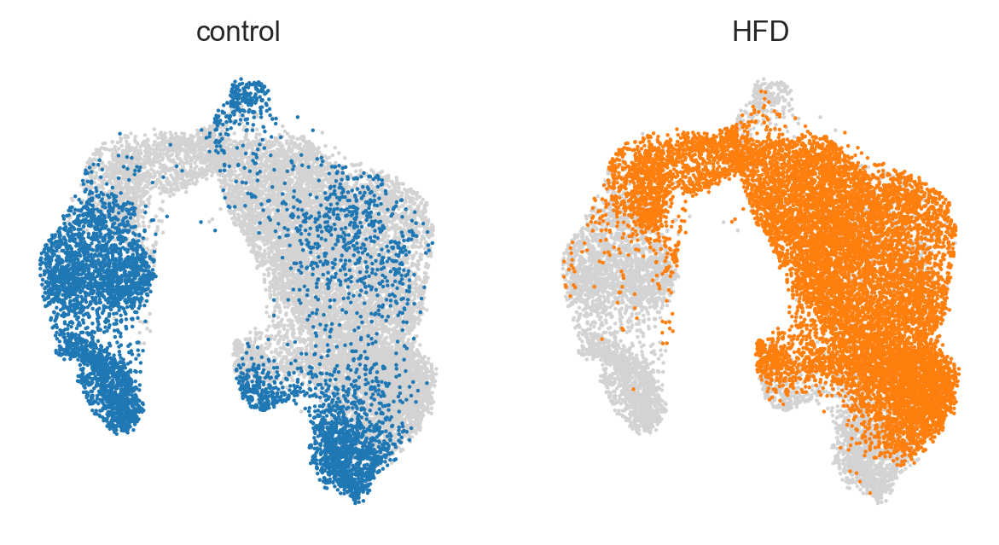

In [37]:
t = 'Liver'
s = 'osteopontin'
author = agg[t][s].obs['author'].unique()[0]
anns = ['control', 'western diet']
ts = ['control', 'HFD']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 3))

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[0], show=False, title=ts[0], legend_loc='', ax=ax1)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[1], show=False, title=ts[1], legend_loc='', ax=ax2)


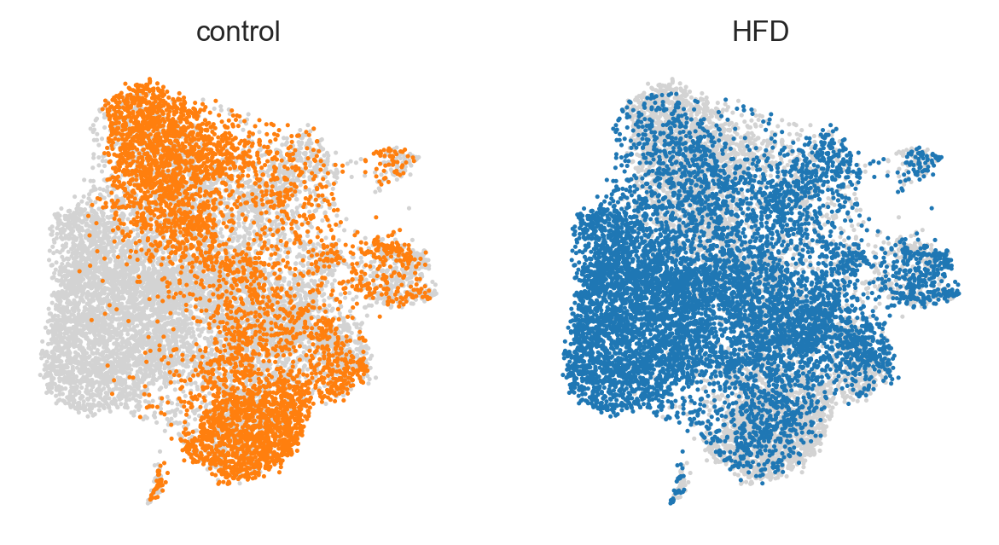

In [38]:
t = 'Adipose'
s = 'LAM'
author = agg[t][s].obs['author'].unique()[0]
anns = ['control', 'HFD']
ts = ['control', 'HFD']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(6, 3))

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[0], show=False, title=ts[0], legend_loc='', ax=ax1)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[1], show=False, title=ts[1], legend_loc='', ax=ax2)

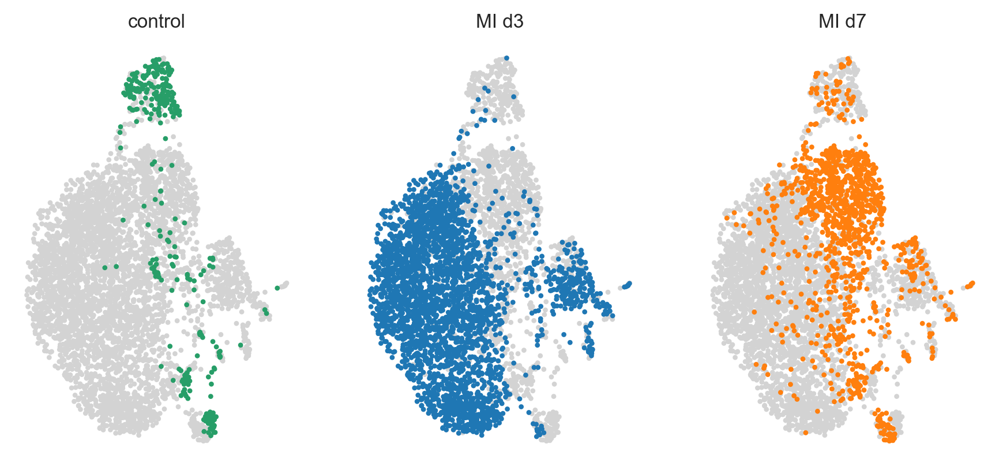

In [39]:
t = 'Heart'
s = 'cardiac'
author = agg[t][s].obs['author'].unique()[0]
anns = ['control', 'MI_d3', 'MI_d7']
ts = ['control', 'MI d3', 'MI d7']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(9, 4))

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[0], show=False, title=ts[0], legend_loc='', ax=ax1)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[1], show=False, title=ts[1], legend_loc='', ax=ax2)

    sc.pl.umap(agg[t][s][agg[t][s].obs['combined_clusters']!='rand'],
               color='concise_annotation', groups=anns[2], show=False, title=ts[2], legend_loc='', ax=ax3)

# Bar plots in Extended Figure 6e

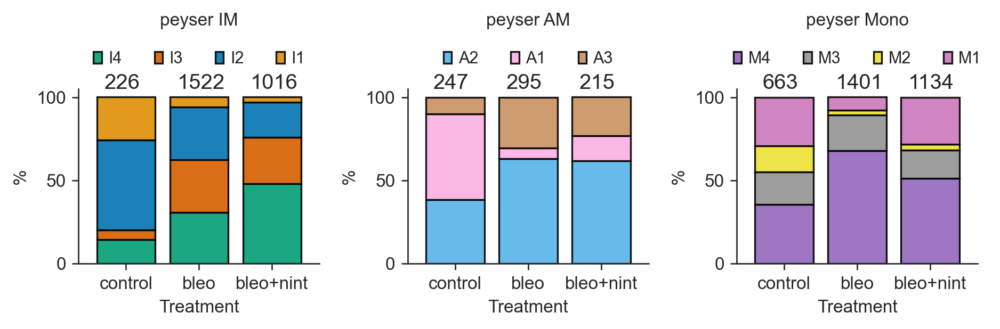

In [40]:
# Strunz
dat = 'peyser'

peyser_order = ['control', 'bleomycin_d10', 'bleomycin+nintedanib_d10']
peyser_samples = ['control', 'bleo', 'bleo+nint']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, figsize=(8, 3))

    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['I'].tolist(), ax1,  order=peyser_order, kind='bar')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax1.set_xticklabels(peyser_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')
    
    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['A'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['A'].tolist(), ax2,  order=peyser_order, kind='bar')
    ax2.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax2.set_xticklabels(peyser_samples, rotation=0)
    ax2.set_ylabel('%')
    ax2.set_xlabel('Treatment')

    
    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['M'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['M'].tolist(), ax3,  order=peyser_order, kind='bar')
    ax3.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax3.set_xticklabels(peyser_samples, rotation=0)
    ax3.set_ylabel('%')
    ax3.set_xlabel('Treatment')

    ax1.set_title(f"{dat} IM", y=1.3)
    ax2.set_title(f"{dat} AM", y=1.3)
    ax3.set_title(f"{dat} Mono", y=1.3)
    
    plt.tight_layout()    

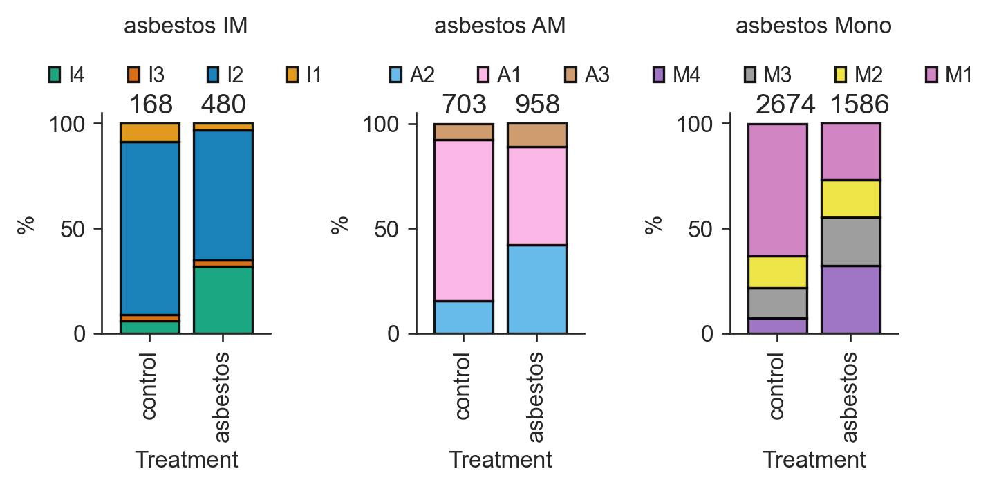

In [41]:
dat = 'asbestos'

asbestos_order = ['control', 'asbestos']
asbestos_samples = ['control', 'bleo', 'bleo+nint']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, figsize=(6, 3.5))

    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['I'].tolist(), ax1,  order=None, kind='bar')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    #ax1.set_xticklabels(peyser_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')
    
    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['A'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['A'].tolist(), ax2,  order=None, kind='bar')
    ax2.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    #ax2.set_xticklabels(peyser_samples, rotation=0)
    ax2.set_ylabel('%')
    ax2.set_xlabel('Treatment')

    
    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['M'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['M'].tolist(), ax3,  order=None, kind='bar')
    ax3.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    #ax3.set_xticklabels(peyser_samples, rotation=0)
    ax3.set_ylabel('%')
    ax3.set_xlabel('Treatment')

    ax1.set_title(f"{dat} IM", y=1.3)
    ax2.set_title(f"{dat} AM", y=1.3)
    ax3.set_title(f"{dat} Mono", y=1.3)
    
    plt.tight_layout()


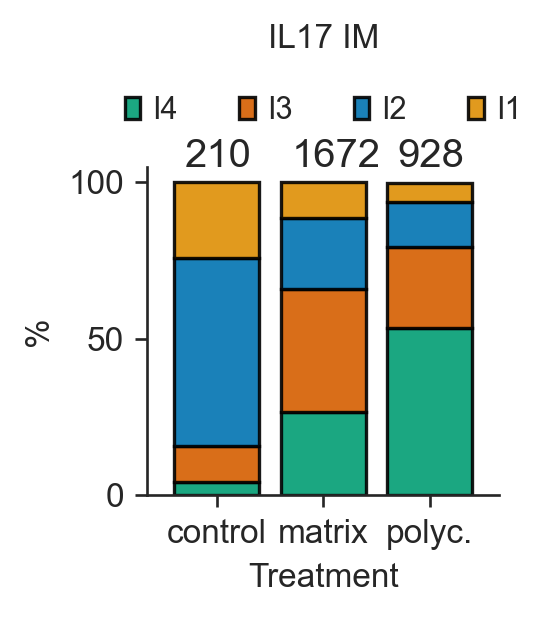

In [42]:
tissue = 'Skeletal muscle'
dat = 'IL17'

IL17_order = ['control', 'injury_bladder_matrix', 'injury_polycaprolactone']
IL17_samples = ['control', 'matrix', 'polyc.']
order = IL17_order

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, figsize=(6, 3))

    utils.plotbarcomplete(agg[tissue][dat][agg[tissue][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['I'].tolist(), ax1,  order=order, kind='bar')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax1.set_xticklabels(IL17_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')

    f.delaxes(ax2)
    f.delaxes(ax3)
    
    ax1.set_title(f"{dat} IM", y=1.3)
    plt.tight_layout()

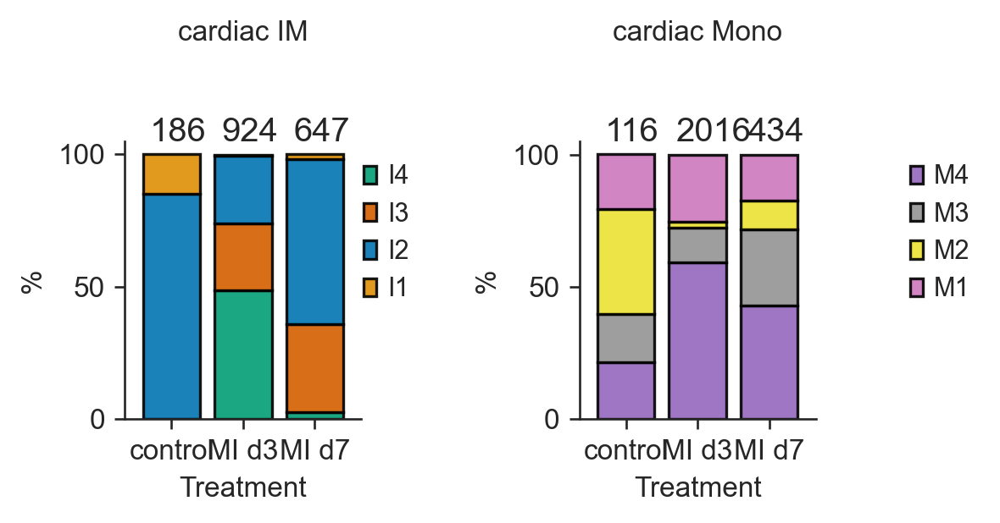

In [43]:
tissue = 'Heart'
dat = 'cardiac'
cardiac_order = ['control', 'MI_d3', 'MI_d7']#[::-1]
cardiac_samples = ['control', 'MI d3', 'MI d7']#[::-1]
order=cardiac_order

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, figsize=(6.5, 3))

    utils.plotbarcomplete(agg[tissue][dat][agg[tissue][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['I'].tolist(), ax1,  order=cardiac_order, kind='bar')
    #ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax1.set_xticklabels(cardiac_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')
    
    utils.plotbarcomplete(agg[tissue][dat][agg[tissue][dat].obs['combined_clusters'].isin(clusters['M'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['M'].tolist(), ax2,  order=cardiac_order, kind='bar')
    #ax3.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax2.set_xticklabels(cardiac_samples, rotation=0)
    ax2.set_ylabel('%')
    ax2.set_xlabel('Treatment')

    ax1.set_title(f"{dat} IM", y=1.3)
    ax2.set_title(f"{dat} Mono", y=1.3)
    
    f.delaxes(ax3)
    
    plt.tight_layout()

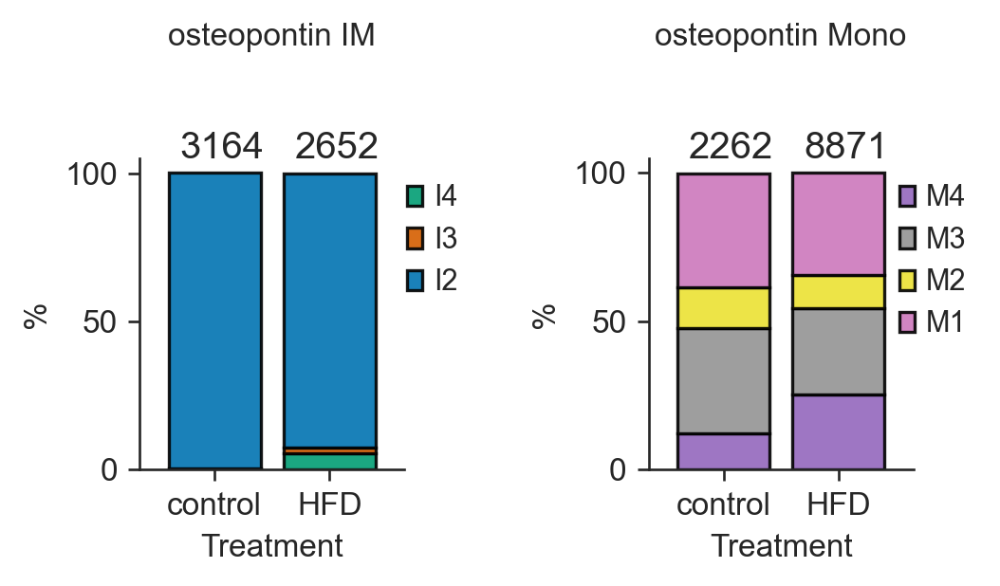

In [44]:
tissue = 'Liver'
dat = 'osteopontin'
osteopontin_order = ['control', 'western diet']#[::-1]
osteopontin_samples = ['control', 'HFD']#[::-1]
order=cardiac_order

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, figsize=(6.5, 3))

    utils.plotbarcomplete(agg[tissue][dat][agg[tissue][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['I'].tolist(), ax1,  order=osteopontin_order, kind='bar')
    #ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax1.set_xticklabels(osteopontin_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')
    
    
    utils.plotbarcomplete(agg[tissue][dat][agg[tissue][dat].obs['combined_clusters'].isin(clusters['M'])].obs, 'concise_annotation', 'combined_clusters',
                    colors['M'].tolist(), ax2,  order=osteopontin_order, kind='bar')
    #ax2.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax2.set_xticklabels(osteopontin_samples, rotation=0)
    ax2.set_ylabel('%')
    ax2.set_xlabel('Treatment')

    ax1.set_title(f"{dat} IM", y=1.3)
    ax2.set_title(f"{dat} Mono", y=1.3)
    
    f.delaxes(ax3)
    
    plt.tight_layout()

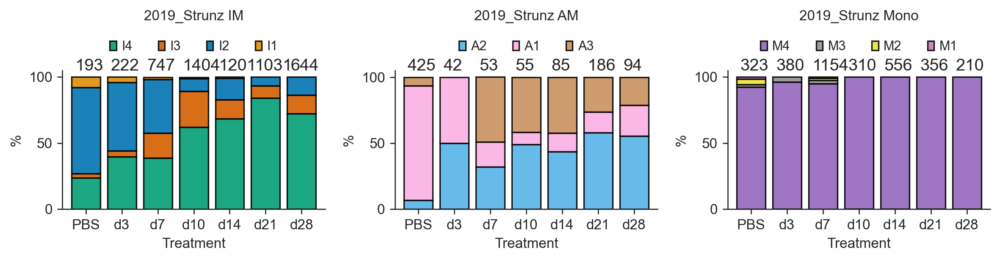

In [45]:
dat = '2019_Strunz'
strunz_samples = ['PBS', 'd3', 'd7', 'd10', 'd14', 'd21', 'd28']

with plt.rc_context({"font.size" : 12}):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, figsize=(10, 3))

    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['I'])].obs, 'concise_annotation', 'combined_clusters', #order_studies_simple,
                    colors['I'].tolist(), ax1,  order=None, kind='bar')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax1.set_xticklabels(strunz_samples, rotation=0)
    ax1.set_ylabel('%')
    ax1.set_xlabel('Treatment')
    
    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['A'])].obs, 'concise_annotation', 'combined_clusters', #order_studies_simple,
                    colors['A'].tolist(), ax2,  order=None, kind='bar')
    ax2.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax2.set_xticklabels(strunz_samples, rotation=0)
    ax2.set_ylabel('%')
    ax2.set_xlabel('Treatment')

    
    utils.plotbarcomplete(agg['Lung'][dat][agg['Lung'][dat].obs['combined_clusters'].isin(clusters['M'])].obs, 'concise_annotation', 'combined_clusters', #order_studies_simple,
                    colors['M'].tolist(), ax3,  order=None, kind='bar')
    ax3.legend(loc='upper center', bbox_to_anchor=(0.5, 1.3), ncol=10, frameon=False)
    ax3.set_xticklabels(strunz_samples, rotation=0)
    ax3.set_ylabel('%')
    ax3.set_xlabel('Treatment')
    
    ax1.set_title(f"{dat} IM", y=1.3)
    ax2.set_title(f"{dat} AM", y=1.3)
    ax3.set_title(f"{dat} Mono", y=1.3)
    plt.tight_layout()
    

# HotSpot Module scoring in Extended Figure 6e

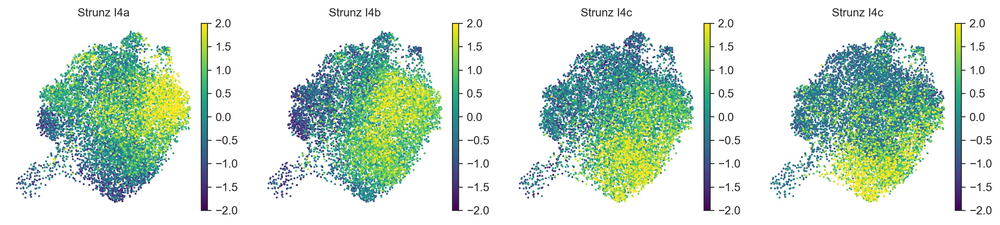

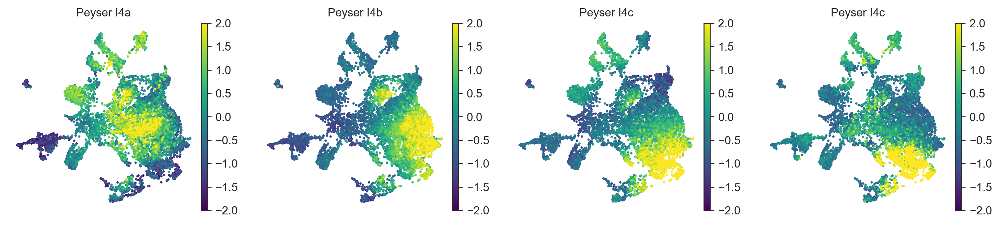

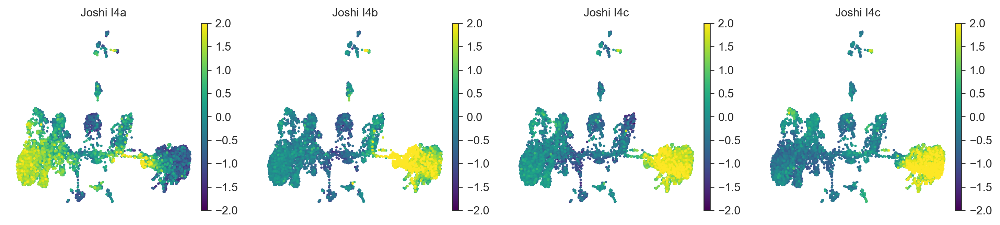

In [46]:
for el in ['2019_Strunz', 'peyser', 'asbestos']:
    author = agg['Lung'][el].obs['author'].unique()[0]
    with plt.rc_context({ "font.size" : 12}):
        f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(15, 3))
        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4a', show=False, title=f'{author} I4a', ax=ax1)

        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4b', show=False, title=f'{author} I4b', ax=ax2)

        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4c', show=False, title=f'{author} I4c', ax=ax3)

        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4d', show=False, title=f'{author} I4c', ax=ax4)

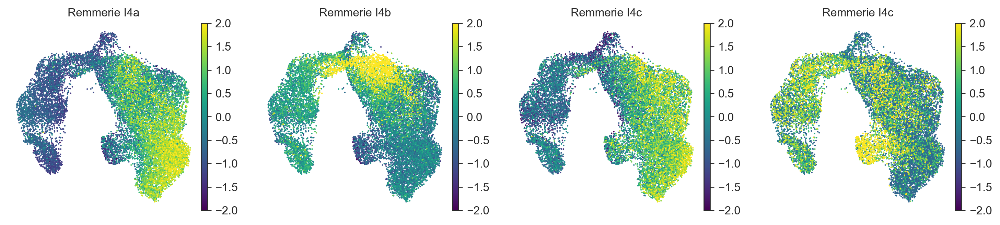

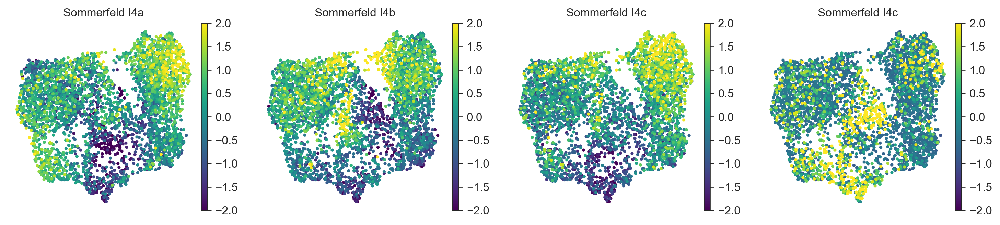

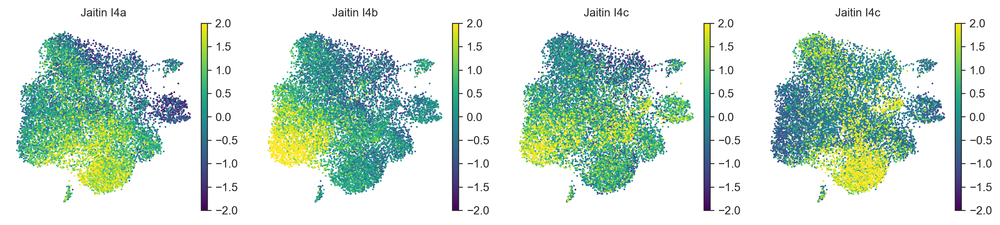

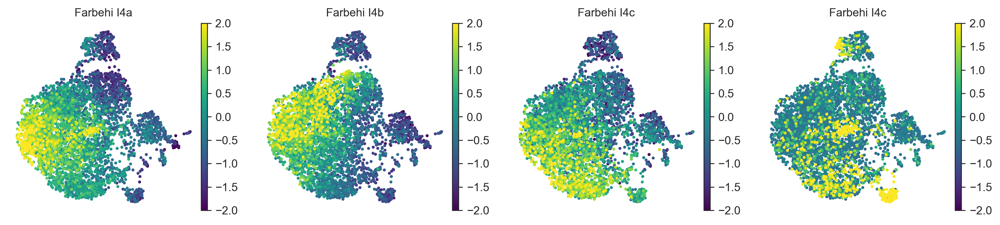

In [47]:
for s, el in zip(['Liver', 'Skeletal muscle', 'Adipose', 'Heart'], ['osteopontin', 'IL17', 'LAM', 'cardiac']):
    author = agg[s][el].obs['author'].unique()[0]
    with plt.rc_context({ "font.size" : 12}):
        f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(15, 3))
        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4a', show=False, title=f'{author} I4a', ax=ax1)

        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4b', show=False, title=f'{author} I4b', ax=ax2)

        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4c', show=False, title=f'{author} I4c', ax=ax3)

        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'], cmap='viridis', vmin=-2, vmax=2,
                   color='zscore_I4d', show=False, title=f'{author} I4c', ax=ax4)

# Single CellNet assignments in Extended figure 6e

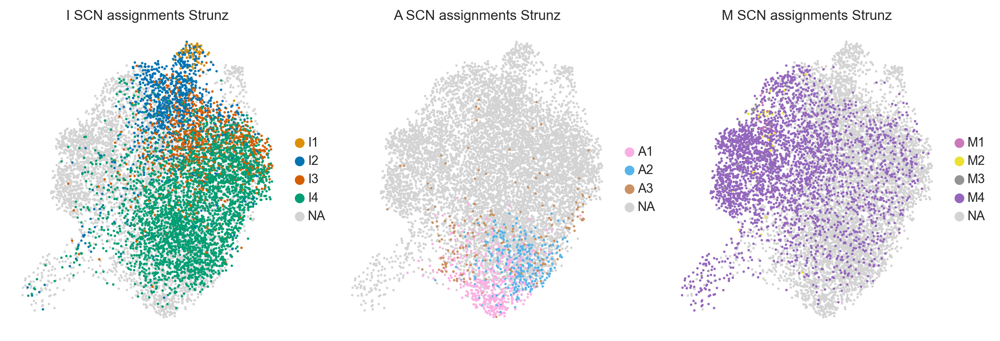

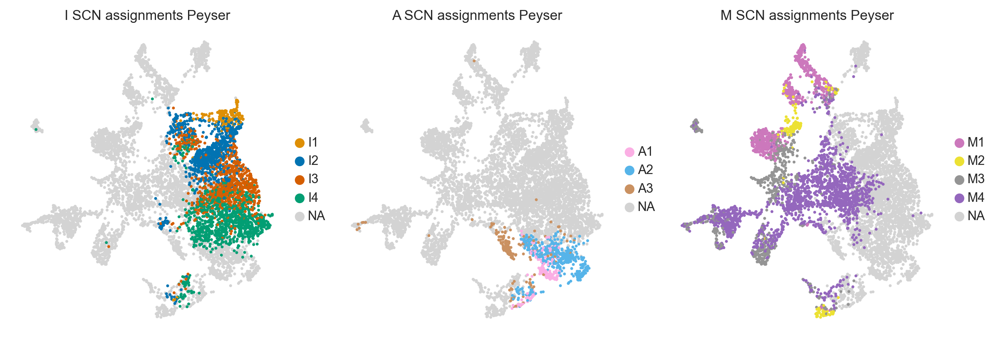

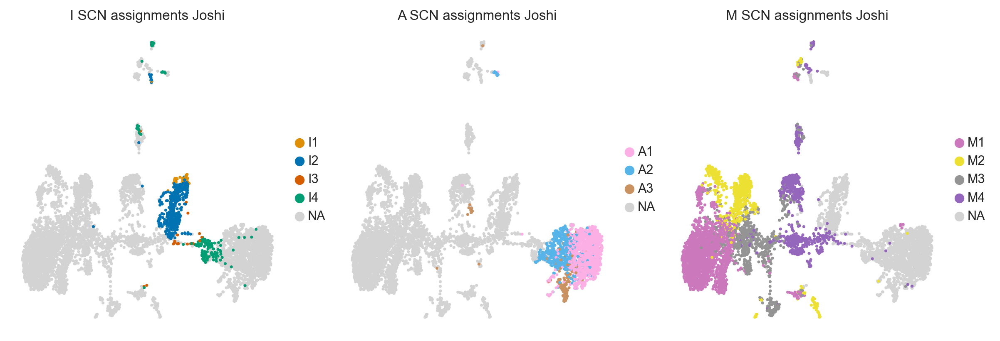

In [48]:
for el in ['2019_Strunz', 'peyser', 'asbestos']:
    author = agg['Lung'][el].obs['author'].unique()[0]
    with plt.rc_context({"font.size" : 12}):
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))
        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'],
                   color='combined_clusters', groups=['I1', 'I2', 'I3', 'I4'], show=False, title=f'I SCN assignments {author}', ax=ax1)

        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'],
                   color='combined_clusters', groups=['A1', 'A2', 'A3'], show=False, title=f'A SCN assignments {author}', ax=ax2)

        sc.pl.umap(agg['Lung'][el][agg['Lung'][el].obs['combined_clusters']!='rand'],
                   color='combined_clusters', groups=['M1', 'M2', 'M3', 'M4'], show=False, title=f'M SCN assignments {author}', ax=ax3)


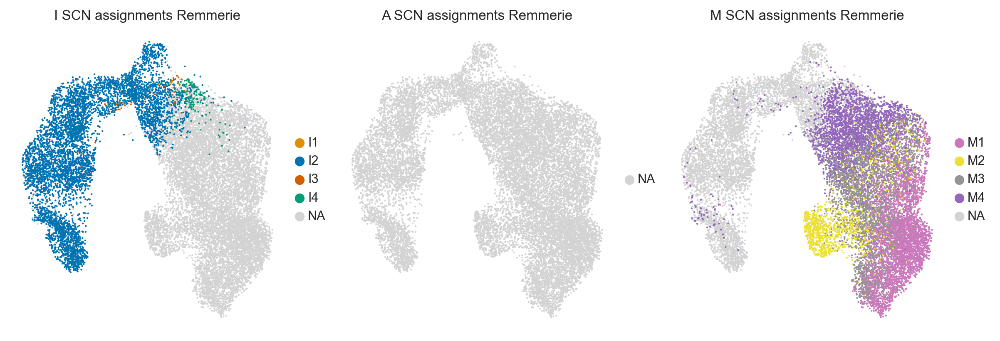

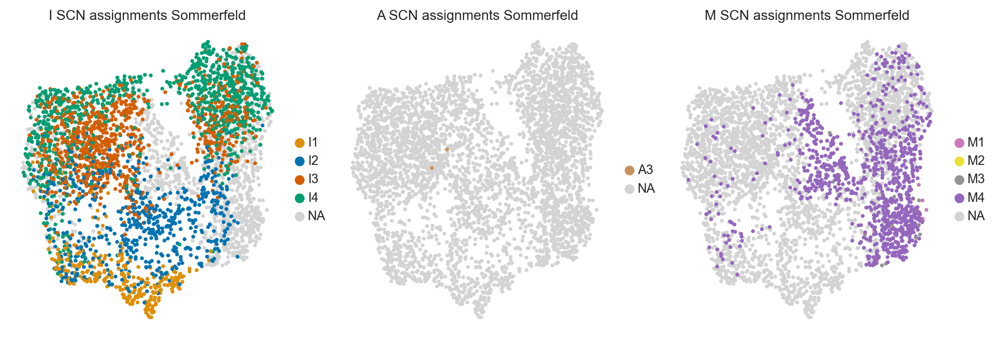

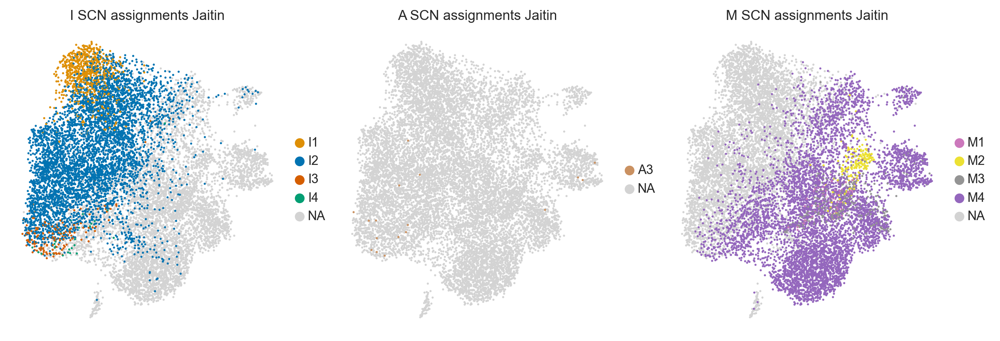

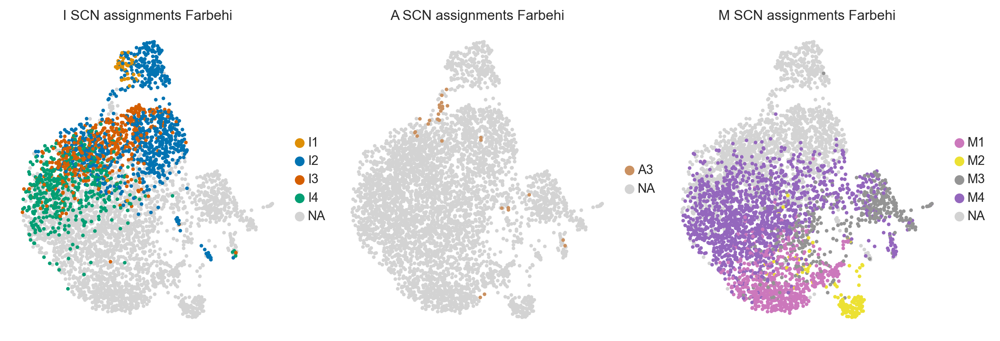

In [49]:
for s, el in zip(['Liver', 'Skeletal muscle', 'Adipose', 'Heart'], ['osteopontin', 'IL17', 'LAM', 'cardiac']):
    author = agg[s][el].obs['author'].unique()[0]
    with plt.rc_context({"font.size" : 12}):
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))
        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'],
                   color='combined_clusters', groups=['I1', 'I2', 'I3', 'I4'], show=False, title=f'I SCN assignments {author}', ax=ax1)

        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'],
                   color='combined_clusters', groups=['A1', 'A2', 'A3'], show=False, title=f'A SCN assignments {author}', ax=ax2)

        sc.pl.umap(agg[s][el][agg[s][el].obs['combined_clusters']!='rand'],
                   color='combined_clusters', groups=['M1', 'M2', 'M3', 'M4'], show=False, title=f'M SCN assignments {author}', ax=ax3)